# OCR Basics: Reading a Newspaper #
1. This is a very basic project for get started with OCR ( Optical Character Recognition) with tools listed below.
2. In this project I have combined Pillow, OpenCV, and Pytesseract to read Newspaper and recognize faces and texts.
3. This image files and other data used in this project is associated with coursera course on OCR.

In [1]:
from zipfile import ZipFile
from PIL import Image, ImageDraw
import pytesseract 
import cv2 as cv
import numpy as np
from IPython.display import display
import os
import math

# loading the face detection classifier
face_cascade = cv.CascadeClassifier('readonly/haarcascade_frontalface_default.xml')

In [3]:
!dir

a-0.png   a-8.png		 module_2-lec5.ipynb
a-10.png  a-9.png		 module_2-lec6.ipynb
a-11.png  assignment_1.ipynb	 module_3.ipynb
a-12.png  black_white_noise.jpg  module_3-lec1.ipynb
a-13.png  greyscale_noise.jpg	 module_3-lec2.ipynb
a-1.png   module_1.ipynb	 module_3-lec3.ipynb
a-2.png   module_1-lec1.ipynb	 module_3-lecoptional.ipynb
a-3.png   module_1-lec2.ipynb	 msi_recruitment.png
a-4.png   module_1-lec3.ipynb	 project.ipynb
a-5.png   module_2.ipynb	 readonly
a-6.png   module_2-lec3.ipynb	 resized_nois.png
a-7.png   module_2-lec4.ipynb	 result.png


In [2]:
# Lets look at a sample image of newspaper
# The display function in IPython module available in Jupyter Notebook allows easy displaying of Image files since 
# imshow() function makes the Kernel die, so be careful!

# Let open the image and store it as PIL image

image = Image.open('a-0.png')

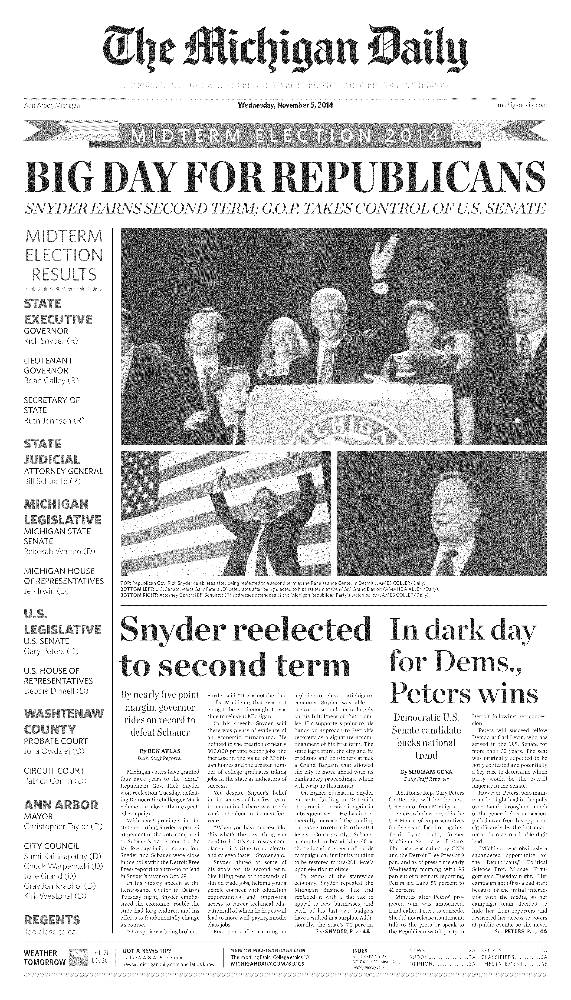

In [5]:
# Binarization or Thresholding of images is necessary for removing noises
# let me show you a demo of this

binarized_image = image.convert('1')
binarized_image

In [6]:
# As you can notice the dimension of the image is way too large so I had to display only a single image
# Our goals are:
    # 1. To crop the newspaper images containing faces and store them.
    # 2. To store the corresponding faces in the page for the sets of faces present on that particular page.

# To crop the newspaper first we would enclose the faces inside a bounding box

def show_faces(img, scale = 1.05):
    
    # first of all we need to convert the image to grayscale so as to recognize faces efficiently
    grey_image = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    
    # Thresholding or Binarizing of an image is necessary for seperating noise from the image as mentioned earlier. 
    # this time binarization is done through opencv, so it has a different syntax, otherwise it works the same
    # It means the pixels that are greater than 170 are turned to 255 others replaced with a 0
    thres_img = cv.threshold(img, 200, 255, cv.THRESH_BINARY)[1]
    
    # loacting the coordinates of the faces in the image and storing it in a face array
    face_arr = face_cascade.detectMultiScale(thres_img, scaleFactor = scale)
    print('We have found {} faces, the coordinates ( in format: (x, y, w, h)) of which are as follows: '.format(len(face_arr)))
    print(face_arr)
    
    rgb_array = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    rgb_image = Image.fromarray(rgb_array)
    draw = ImageDraw.Draw(rgb_image)
    
    print('Drawing the bouding boxes')
    for x, y, w, h in face_arr:
        draw.rectangle((x, y, x+w, y+h), outline = 'red', width = 10)
    
    display(rgb_image)
    

We have found 33 faces, the coordinates ( in format: (x, y, w, h)) of which are as follows: 
[[ 499 1573   66   66]
 [3141 1736  274  274]
 [1955  210  155  155]
 [2506  210  161  161]
 [1972 1887  202  202]
 [ 193 2068   31   31]
 [2816 2181   34   34]
 [ 443 2506   30   30]
 [2554 1961  184  184]
 [1156 2003  206  206]
 [1675 2025  198  198]
 [1973 2058  198  198]
 [2865 2102  187  187]
 [2408 1251   87   87]
 [1417 2365  233  233]
 [1837 2884   60   60]
 [2663 3061  275  275]
 [2362 3674   27   27]
 [ 238 3231   65   65]
 [ 316 3232   61   61]
 [ 927 3731   26   26]
 [3290 3166  117  117]
 [2942 3173  103  103]
 [1634 3174   79   79]
 [ 241 3924   60   60]
 [ 438 4210   31   31]
 [ 400 4840   30   30]
 [2425 4424  256  256]
 [ 447 5026   63   63]
 [ 454 5752   60   60]
 [ 252 5753   61   61]
 [ 139 5748   72   72]
 [1530 5558  132  132]]
Drawing the bouding boxes


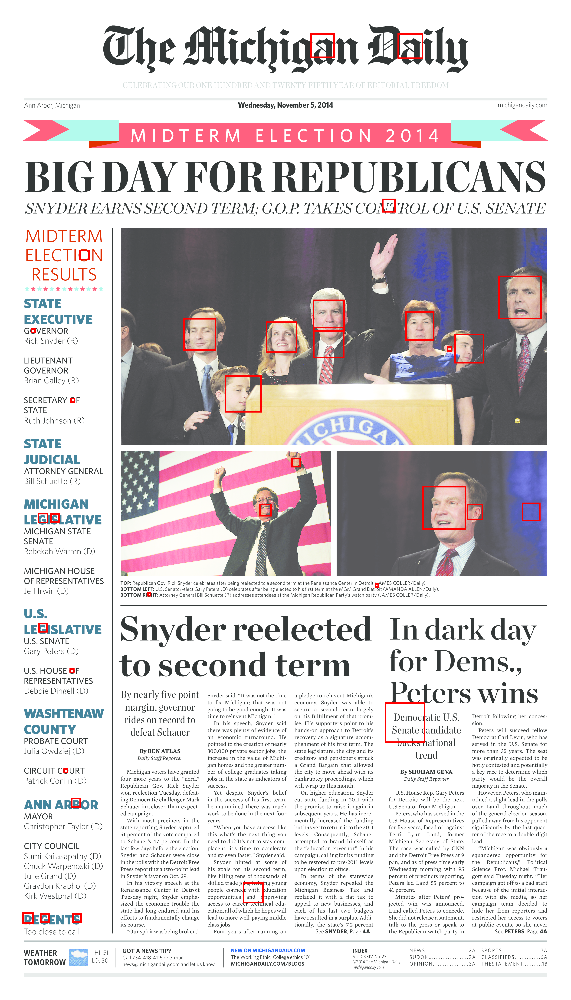

In [10]:
img = cv.imread('a-0.png')
show_faces(img)

In [11]:
# we can notice that though all the faces in the image are marked, but there is a large amount of false positives, 
# which is a thing to worry about,  lets vary the scale factor

We have found 6 faces, the coordinates ( in format: (x, y, w, h)) of which are as follows: 
[[1972 1888  198  198]
 [1155 2001  207  207]
 [3147 1744  254  254]
 [1676 2029  191  191]
 [2668 3062  279  279]
 [2551 1963  186  186]]
Drawing the bouding boxes


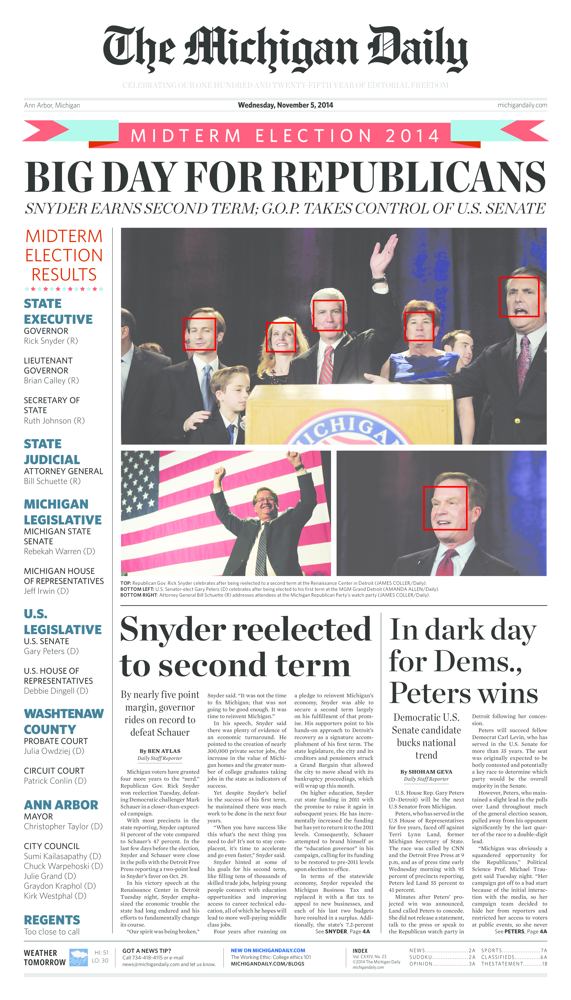

In [12]:
show_faces(img, 1.3)

In [33]:
# we can see that though all the faces are not determined, still there are no false positives, and we would stick to this 
# model of the bounding boxes, hence we observe that a scale of 1.3 is ok for us

def return_cropped_imgs(image, scale = 1.35):
    max_size = (100, 100)
    grey_image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
    
    # Thresholding or Binarizing of an image is necessary for seperating noise from the image as mentioned earlier. 
    # this time binarization is done through opencv, so it has a different syntax, otherwise it works the same
    # It means the pixels that are greater than 170 are turned to 255 others replaced with a 0
    thres_img = cv.threshold(grey_image, 200, 255, cv.THRESH_BINARY)[1]
    
    # loacting the coordinates of the faces in the image and storing it in a face array
    face_arr = face_cascade.detectMultiScale(thres_img, scaleFactor = scale)
    
    rgb_array = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    rgb_image = Image.fromarray(rgb_array)
    
    contact_sheet = Image.new('RGB', (max_size[0]*3, max_size[1]*(math.ceil(len(face_arr)/3))) )
    
    x_ = 0
    y_ = 0
    for x, y, w, h in face_arr:
        crop_img = rgb_image.crop((x, y, x+w, y+h))
        
        crop_img.thumbnail(max_size)
        contact_sheet.paste(crop_img, (x_, y_))  
    
        if(x_ + max_size[0] == contact_sheet.width):
            x_ = 0
            y_ = y_ + max_size[0]
        else:
            x_ = x_ + max_size[0]
    return contact_sheet

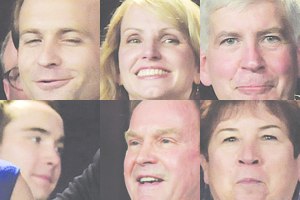

In [34]:
all_images = return_cropped_imgs(cv.imread('a-0.png'))
all_images

In [35]:
img = Image.open('a-0.png')
text = pytesseract.image_to_string(img.convert('1'))
text

"Ann Arbor, Michigan\n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\nWednesday, November 5, 2014\n\n \n\n \n\nmichigandally.com\n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\nSNYDER EARNS SECOND TERM; G.O.P. TAKES CONTROL OF U.S. SENATE\n\nMIDTERM\nELECTION\nRESULTS\n\nhe te ek ee te\n\n \n\nGOVERNOR\nRick Snyder (R)\n\n \n\n \n\n \n\n \n\nLIEUTENAN\nGOVERNO\nBrian Calley (R)\n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\nSECRE\nATE\nRuth Johnson (R)\n\n \n\n \n\nARY OF\n\n \n\n \n\n \n\n \n\n \n\na)\n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\nTORNEY GENERAL\nill Schuette CR)\n\n \n\n \n\nw\n\n \n\n \n\n \n\n \n\nMICHIGAN STATE\nSENATE\nRebeka\n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\nWarren (D)\n\n \n\nMICHIGAN HOUSE\nOF REPRESENTATIVES\nJeff Irwin CD)\n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\nU.S. SENATE\nGary Peters (D)\n\n \n\n \n\nU.S. HOUSE OF\n\n \n\n \n\n \n\n \n\nREPRESENTATIVES\nDebbie Dingel\n\n \n\n \n

In [36]:
# You may see that the text retrieved from the paper is full of noise and is not correctly ordered due to multiple columns
# existence in the same image. But our goal is to read text and identify if it is present in the page, if so then 
# to display the faces present

In [47]:
def search(keyword):
    print('Results for keyword:{}'.format(keyword))
    print('-'*100)
    if keyword in text:
        print('Found in the newspaper!!! :)')
        display(all_images)
    else:
        print('{} is not found in the Newspaper! :/'.format(keyword))
    print('\n\n')

Results for keyword:Christopher
----------------------------------------------------------------------------------------------------
Found in the newspaper!!! :)


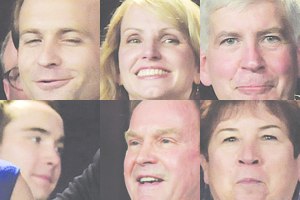

In [48]:
# searching for the word 'christopher' we obtain the following results
search('Christopher')

Results for keyword:Mark
----------------------------------------------------------------------------------------------------
Found in the newspaper!!! :)


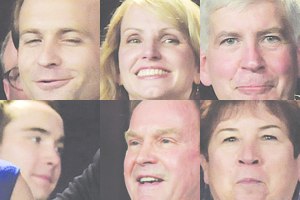

In [49]:
# Searching for the word 'Mark' , we obtain the following results
search('Mark')

In [51]:
search('Debojit')

Results for keyword:Debojit
----------------------------------------------------------------------------------------------------
Debojit is not found in the Newspaper! :/





Results for keyword:Bill
----------------------------------------------------------------------------------------------------
Found in the newspaper!!! :)


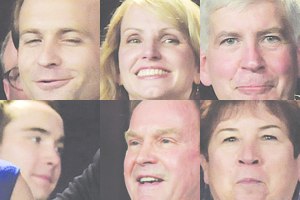

In [52]:
search('Bill')

In [ ]:
# So thats it, It is my very first basic OCR project where I got to use PIL, OpenCV and Pytesseracts to work with image 
# files and search the text accorinding to image file